In [1]:
import pandas as pd
import scipy as sp
from scipy.signal import savgol_filter
import plotly.express as px

In [41]:
with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 Bx [INT].txt', 'r') as file:
    lines = file.readlines()
df = pd.DataFrame(columns=lines[1].split())
for i, line in enumerate(lines[2:]):
    df.loc[i] = line.split()
df

<>:1: SyntaxWarning: invalid escape sequence '\J'
<>:1: SyntaxWarning: invalid escape sequence '\J'
C:\Users\Eugene\AppData\Local\Temp\ipykernel_31280\1368799600.py:1: SyntaxWarning: invalid escape sequence '\J'
  with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 Bx [INT].txt', 'r') as file:


,Time,Bx
0,183,19875.0577920207
1,183.001419078441,19874.998531874
2,183.002838156881,19874.8998993791
3,183.004257235322,19874.7451600361
4,183.005676313762,19874.5980488182
...,...,...
65531,275.993629286238,19833.8283673
65532,275.995048364678,19833.4318178602
65533,275.996467443119,19833.0855499728
65534,275.99788652156,19832.7997781931


In [44]:
df = df.set_index('Time')

In [75]:
df.index = df.index.astype('float')
df.Bx = df.Bx.astype('float')

In [82]:
with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 By [INT].txt', 'r') as file:
    linesy = file.readlines()
with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 Bz [INT].txt', 'r') as file:
    linesz = file.readlines()
for liney, linez in zip(linesy[2:], linesz[2:]):
    df.loc[float(liney.split()[0]), 'By'] = float(liney.split()[1])
    df.loc[float(linez.split()[0]), 'Bz'] = float(linez.split()[1])

<>:1: SyntaxWarning: invalid escape sequence '\J'
<>:3: SyntaxWarning: invalid escape sequence '\J'
<>:1: SyntaxWarning: invalid escape sequence '\J'
<>:3: SyntaxWarning: invalid escape sequence '\J'
C:\Users\Eugene\AppData\Local\Temp\ipykernel_31280\3018841052.py:1: SyntaxWarning: invalid escape sequence '\J'
  with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 By [INT].txt', 'r') as file:
C:\Users\Eugene\AppData\Local\Temp\ipykernel_31280\3018841052.py:3: SyntaxWarning: invalid escape sequence '\J'
  with open('../Materials\Jun-Oct data\LVIV Jul-Oct 2020 Bz [INT].txt', 'r') as file:


In [140]:
df.to_csv('data_long.csv')

In [12]:
df1 = pd.read_csv('data_long.csv', index_col=0)
df1 = (df1 - df1.mean()) / df1.std()
df2 = pd.read_csv('data.csv', index_col=0)
# df2 = (df2.iloc[0::2].reset_index(drop=True) + df2.iloc[1::2].reset_index(drop=True)) / 2
df2 = df2.iloc[::2]
df2 = (df2 - df2.mean()) / df2.std()
df = pd.concat([df1, df2])

In [13]:
window = 100
# window = sp.signal.windows.bartlett(20)
deg = 5
df_smooth = pd.DataFrame({'x': savgol_filter(df.x, window, deg), 'y': savgol_filter(df.y, window, deg), 'z': savgol_filter(df.z, window, deg)})
# df_smooth = pd.DataFrame({'x': sp.signal.convolve(df.x, window), 'y': sp.signal.convolve(df.y, window), 'z': sp.signal.convolve(df.z, window)})
df_smooth.to_csv('data_long_smooth.csv', index=0)

<Axes: >

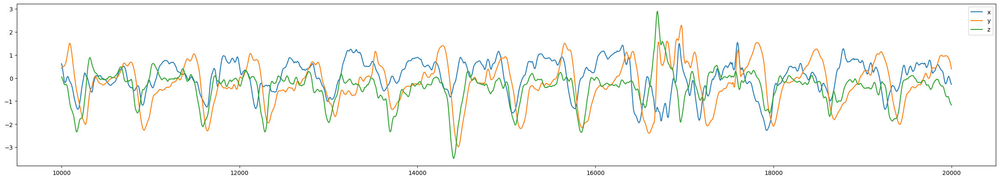

In [14]:
df_smooth.iloc[10000:20000].plot(figsize=(30, 5))

In [15]:
fig = px.line(df_smooth, y=['x', 'y', 'z'], width=7000, height=400)
fig

In [154]:
fig = px.scatter_3d(df_smooth, 'x', 'y', 'z', height=1200, width=1200)
fig.update_traces(marker=dict(size=2))